In [1]:
import pandas as pd
import os
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import numpy as np
from sklearn.metrics import r2_score, mean_squared_error

import sys
sys.path.insert(1, os.path.join(sys.path[0], '..'))
from utils.geo_plot import plot_locs
from utils.plot import to_gif, scatter_preds

## Get data

In [ ]:
data_dir = '/cephyr/NOBACKUP/groups/globalpoverty1/data/'
MIN_IWI = 0
MAX_IWI = 100
MODEL_NAMES = ['resnet', 'bidirectional_resnet_lstm', 'bidirectional_resnet_lstm_10']

df = pd.read_csv(os.path.join(data_dir, 'dhs_clusters.csv'), float_precision='high', index_col=False)
# get all tfrecords
tfrecord_files = np.asarray(create_full_tfrecords_paths(data_dir))
df['file'] = tfrecord_files
df['name'] = df['country'].apply(lambda x: rename_names[x])
df['iso_a3'] = df['country'].apply(lambda x: iso_a3_codes[x])
df['i'] = df['year'].apply(lambda x: (x-1990) // 3)

results_dict = {}
for fold_config in ['incountry', 'ooc', 'oots']:
    results_dict[fold_config] = {}
    for model_name in MODEL_NAMES:
        results_path = os.path.join(data_dir, 'results', fold_config, model_name + '.csv')
        results_df = pd.read_csv(results_path, float_precision='high', index_col=False)
        results_df = results_df.set_index('Unnamed: 0')
        # Rescale prediction values
        results_df.loc[:, results_df.columns != 'fold'] = (MAX_IWI - MIN_IWI) * results_df.loc[:, results_df.columns != 'fold'] + MIN_IWI
        results_df = df.merge(results_df, left_index=True, right_index=True)
        results_df['error'] = results_df.apply(lambda x: abs(x['iwi'] - x['y_i']), axis=1)
        results_dict[fold_config][model_name] = results_df

In [13]:
def get_compare_df(data_dir, fold_config):
    
    # Get base
    df = pd.read_csv(os.path.join(data_dir, 'dhs_clusters.csv'), float_precision='high', index_col=False)
    
    # Get predictions
    results_dir = os.path.join(data_dir, 'results', fold_config)

    lstm_path = os.path.join(results_dir, 'bidirectional_resnet_lstm.csv')
    lstm_df = pd.read_csv(lstm_path, float_precision='high', index_col=False)
    lstm_df = lstm_df.rename({'y_i': 'lstm_pred'})
    lstm_df = lstm_df.set_index('Unnamed: 0')

    resnet_path = os.path.join(results_dir, 'resnet.csv')
    resnet_df = pd.read_csv(resnet_path, float_precision='high', index_col=False)
    resnet_df = resnet_df.rename({'y_i': 'resnet_pred'})
    resnet_df = resnet_df.set_index('Unnamed: 0')
    
    # Add preds
    df['five_frames_pred'] = 100 * lstm_df['y_i']
    df['single_frame_pred'] = 100 * resnet_df['y_i']
    
    # Get mse
    df['five_frames_err'] = abs(df['five_frames_pred'] - df['iwi'])
    df['ten_frames_err'] = abs(df['ten_frames_pred'] - df['iwi'])
    df['single_frame_err'] = abs(df['single_frame_pred'] - df['iwi'])
    
    assert all(resnet_df['fold'] == lstm_df['fold'])
    df['fold'] = resnet_df['fold']
    return df

data_dir = '/cephyr/NOBACKUP/groups/globalpoverty1/data'
fold_config = 'ooc'
df = get_compare_df(data_dir, fold_config)
df

KeyError: 'ten_frames_pred'

In [3]:
df.groupby('fold').mean()

,survey_start_year,year,lat,lon,households,rural,iwi,five_frames_pred,single_frame_pred,five_frames_mse,single_frame_mse
fold,,,,,,,,,,,
A,2007.048095,2007.099168,16.088377,29.768729,17.949978,0.546912,49.765558,47.425361,42.511684,115.962108,223.868417
B,2011.720542,2011.841716,0.513680,15.409961,26.793880,0.609391,31.001675,28.955361,27.657625,117.448709,137.293967
C,2008.738677,2008.878814,-0.611345,12.718089,22.979571,0.666174,27.047623,27.101102,27.550962,135.668866,139.081301
D,2009.501128,2009.645747,5.434385,13.259432,21.757292,0.665017,23.577008,26.546906,27.292559,77.817514,105.626516
E,2008.951076,2009.149319,-4.483462,23.623464,23.529732,0.622661,29.566228,28.557010,28.725755,143.783155,164.563333


Improvment for each year

In [12]:
df['ts_improvement'] = df['single_frame_err'] - df['five_frames_err']
df.groupby('year').mean()[['ts_improvement']].plot.bar()

KeyError: 'ten_frames_err'

Improvment for each country

<AxesSubplot:xlabel='country'>

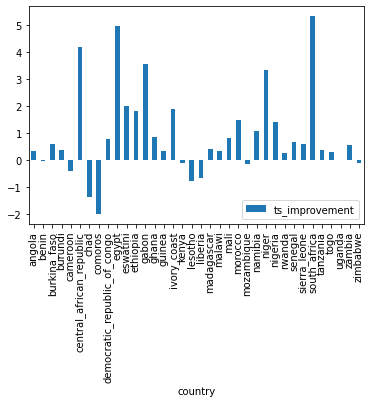

In [13]:
df.groupby('country').mean()[['ts_improvement']].plot.bar()

MSE for the different models

In [24]:
df.groupby('rural').mean()[['ts_improvement']]

,ts_improvement
rural,
0,2.395091
1,0.438429


<AxesSubplot:xlabel='country'>

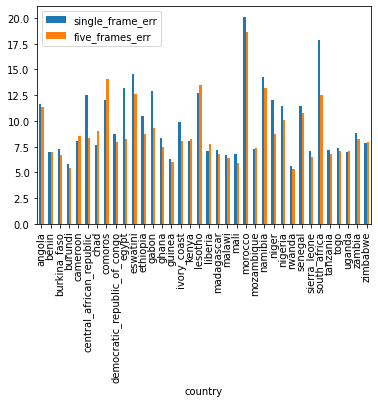

In [14]:
df.groupby('country').mean()[['single_frame_err', 'five_frames_err']].plot.bar()

<AxesSubplot:xlabel='households', ylabel='five_frames_mse'>

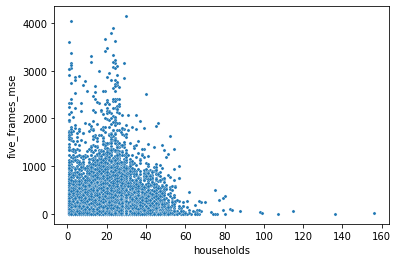

In [7]:
sns.scatterplot(data=df, x='households', y='five_frames_mse', s=10)

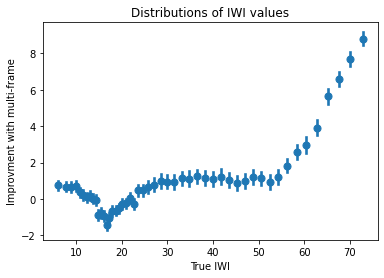

In [15]:
sns.regplot(data=df, x='iwi', y='ts_improvement', x_bins=50, fit_reg=None)
plt.xlabel('True IWI')
plt.ylabel('Improvment with multi-frame')
plt.title('Distributions of IWI values')
plt.show()

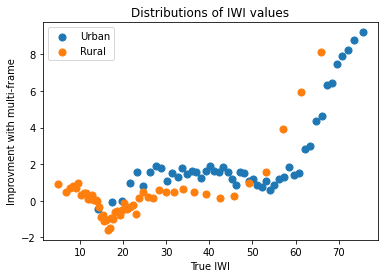

In [21]:
sns.regplot(data=df[df['rural'] == 0], x='iwi', y='ts_improvement', x_bins=50, fit_reg=None, ci=None)
sns.regplot(data=df[df['rural'] == 1], x='iwi', y='ts_improvement', x_bins=50, fit_reg=None, ci=None)
plt.xlabel('True IWI')
plt.ylabel('Improvment with multi-frame')
plt.title('Distributions of IWI values')
plt.legend(['Urban', 'Rural'])
plt.show()

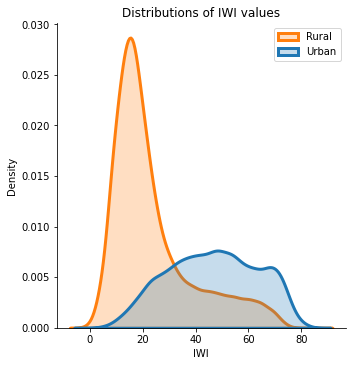

In [10]:
urban_indices = df['rural'] == 0
sns.displot(data=df, hue='rural', x='iwi', kind='kde', 
            legend=False, fill=True, linewidth=3)

plt.xlabel('IWI')
plt.title('Distributions of IWI values')
plt.legend(['Rural', 'Urban'])
plt.show()

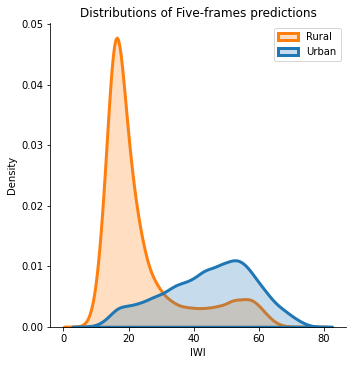

In [11]:
urban_indices = df['rural'] == 0
sns.displot(data=df, hue='rural', x='five_frames_pred', kind='kde', 
            legend=False, fill=True, linewidth=3)

plt.xlabel('IWI')
plt.title('Distributions of Five-frames predictions')
plt.legend(['Rural', 'Urban'])
plt.show()

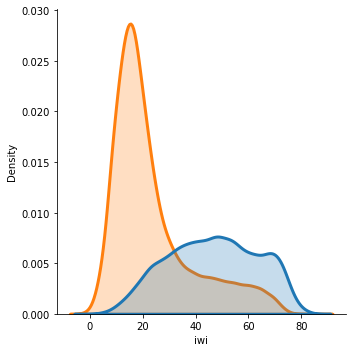

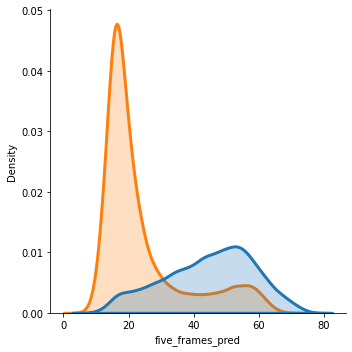

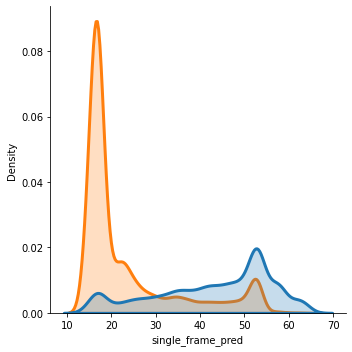

In [12]:
urban_indices = df['rural'] == 0
sns.displot(data=df, hue='rural', x='iwi', kind='kde', 
            legend=False, fill=True, linewidth=3)
sns.displot(data=df, hue='rural', x='five_frames_pred', kind='kde', 
            legend=False, fill=True, linewidth=3)
sns.displot(data=df, hue='rural', x='single_frame_pred', kind='kde', 
            legend=False, fill=True, linewidth=3)

<GeoAxesSubplot:>

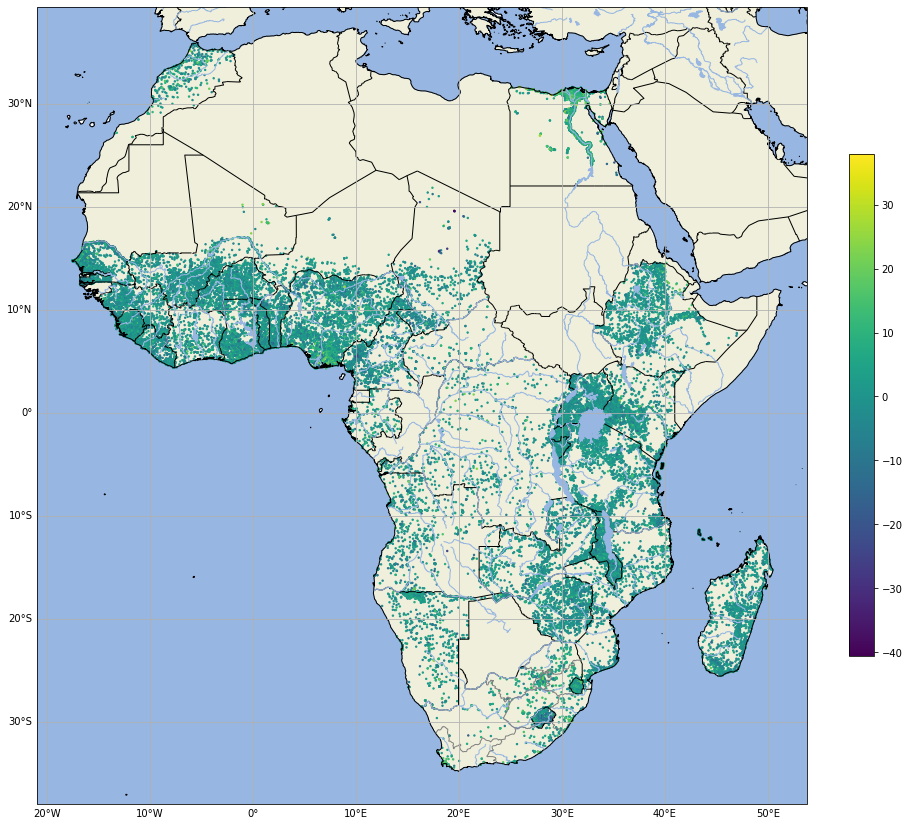

In [18]:
dhs_locs = df[['lat', 'lon']].values
plot_locs(locs=dhs_locs, colors=df['ts_improvement'].values)

<GeoAxesSubplot:title={'center':'Rural'}>

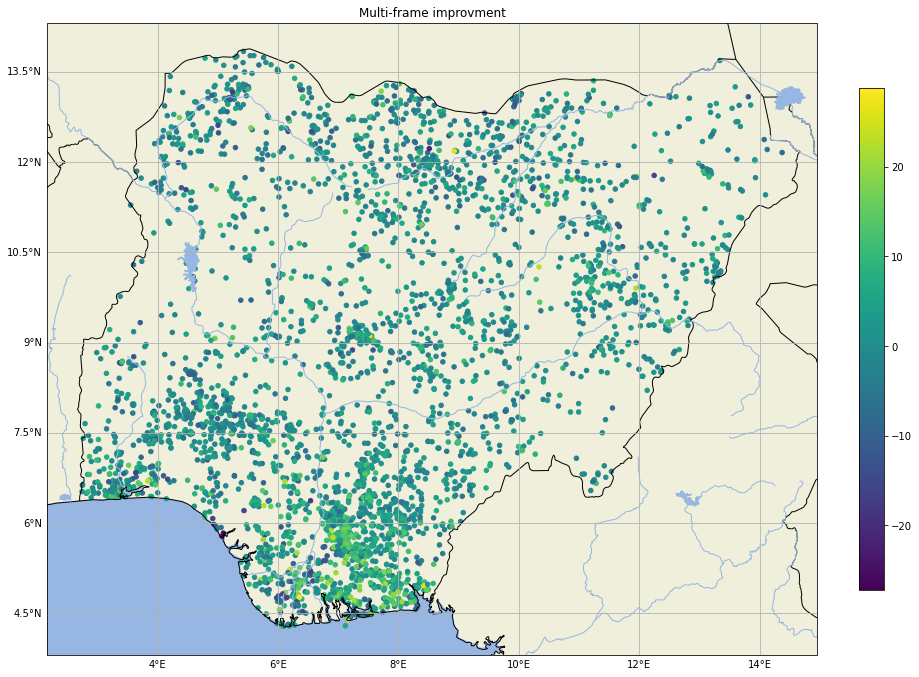

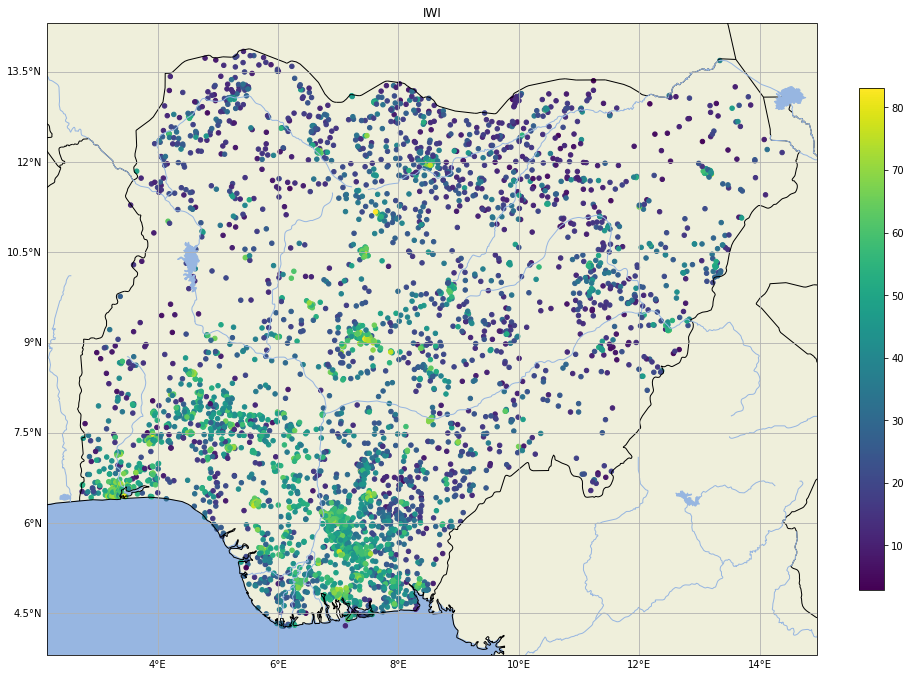

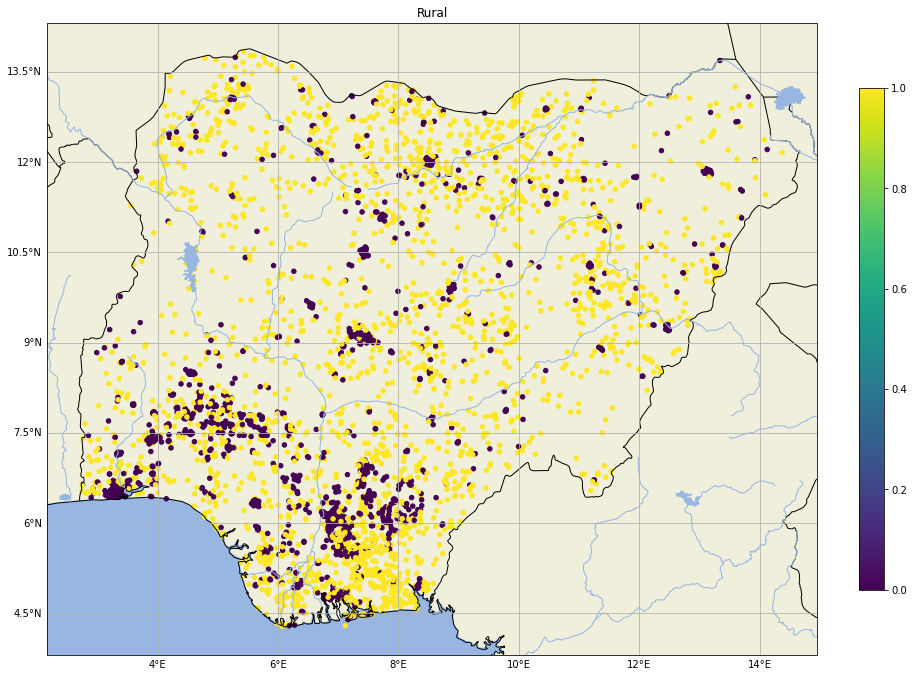

In [19]:
nga_df = df[df['country'] == 'nigeria']
nga_locs = nga_df[['lat', 'lon']].values
plot_locs(locs=nga_locs, colors=nga_df['ts_improvement'].values, title='Multi-frame improvment', s=20)
plot_locs(locs=nga_locs, colors=nga_df['iwi'].values, title='IWI', s=20)
plot_locs(locs=nga_locs, colors=nga_df['rural'].values, title='Rural', s=20)

In [15]:
df.dropna()

,country,survey_start_year,year,lat,lon,GID_1,GID_2,households,rural,iwi,five_frames_pred,single_frame_pred,five_frames_mse,single_frame_mse,fold,ts_improvement
0,angola,2006,2006,-12.169283,13.859255,AGO.2,AGO.2.9,20,0,68.096300,14.628907,14.636230,2858.762146,2857.979116,E,-0.783030
1,angola,2006,2006,-12.361700,14.778201,AGO.2,AGO.2.2,19,1,10.609053,23.293456,25.024414,160.894075,207.802628,E,46.908553
2,angola,2006,2006,-10.827451,14.342114,AGO.7,AGO.7.1,25,1,29.973928,22.221680,15.502930,60.097352,209.409788,E,149.312436
3,angola,2006,2006,-9.991311,14.898295,AGO.7,AGO.7.5,1,1,7.704135,20.556640,24.926758,165.186885,296.618743,E,131.431858
4,angola,2006,2006,-11.518893,14.750437,AGO.7,AGO.7.10,24,1,13.371826,15.729980,14.685059,5.560892,1.724582,E,-3.836310
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57190,zimbabwe,2015,2015,-20.911177,30.008579,ZWE.10,ZWE.10.6,28,1,27.791567,18.115234,16.796875,93.631430,120.883263,B,27.251833
57191,zimbabwe,2015,2015,-20.402214,29.860028,ZWE.10,ZWE.10.8,28,1,36.929878,22.033691,23.364258,221.896398,184.026056,B,-37.870342
57192,zimbabwe,2015,2015,-20.724753,30.172833,ZWE.10,ZWE.10.6,27,1,24.406326,14.288330,16.748047,102.373835,58.649231,B,-43.724604
57193,zimbabwe,2015,2015,-19.453466,29.820084,ZWE.10,ZWE.10.4,28,0,59.887344,46.728516,40.356445,173.154761,381.456026,B,208.301265


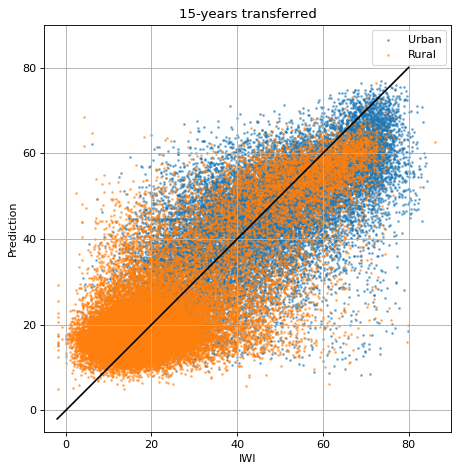

In [16]:
def plot_urban_rural_predictions(labels, preds, urban_indices, rural_indices):
    '''
    Args
    - labels: np.array, shape [N]
    - preds: dict, model_name => np.array, shape [N]
    - urban_indices: np.array, shape [num_urban]
    - rural_indices: np.array, shape [num_rural]
    '''
    plt.figure(figsize=(6, 6), dpi=80)
    plt.scatter(
        x=labels[urban_indices],
        y=preds[urban_indices],
        s=2, label='Urban', alpha=0.5)
    plt.scatter(
        x=labels[rural_indices],
        y=preds[rural_indices],
        s=2, label='Rural', alpha=0.5)
    plt.grid(True)
    #plt.set_aspect('equal')
    plt.gca().set_aspect('equal')
    plt.xlim(-5, 90)
    plt.ylim(-5, 90) 
    plt.xlabel('IWI')
    plt.ylabel('Prediction')
    plt.title('15-years transferred')
    xy_line = np.array([-2, 80])
    plt.plot(xy_line, xy_line, color='black')
    plt.legend()
    plt.tight_layout()
    
    plt.show()

urban_indices = np.where(df['rural'] == 0)
rural_indices = np.where(df['rural'] == 1)
plot_urban_rural_predictions(df['iwi'].values, df['five_frames_pred'].values, urban_indices, rural_indices)

Evaluate performance on individual surveys

In [4]:
def r2_rmse(g):
    g = g.dropna()
    five_frames_r2 = r2_score(g['iwi'], g['five_frames_pred'])
    five_frames_rmse = np.sqrt(mean_squared_error(g['iwi'], g['five_frames_pred']))
    single_frame_r2 = r2_score(g['iwi'], g['single_frame_pred'])
    single_frame_rmse = np.sqrt(mean_squared_error(g['iwi'], g['single_frame_pred']))
    return pd.Series({
        'five_frames_r2': five_frames_r2,
        'five_frames_rmse': five_frames_rmse,
        'single_frame_r2': single_frame_r2,
        'single_frame_rmse': single_frame_rmse,
        'n_surveys': len(g)
    })

survey_results = df.groupby(['country', 'survey_start_year']).apply(r2_rmse).reset_index()
survey_results

,country,survey_start_year,five_frames_r2,five_frames_rmse,single_frame_r2,single_frame_rmse,n_surveys
0,angola,2006,0.238342,19.084742,0.029402,21.543981,115.0
1,angola,2011,0.769388,11.093898,0.593349,14.731744,230.0
2,angola,2015,0.650215,14.459190,0.691507,13.578953,624.0
3,benin,1996,0.481106,8.066255,0.399956,8.674093,190.0
4,benin,2001,0.535429,8.545869,0.487950,8.971946,234.0
...,...,...,...,...,...,...,...
133,zambia,2018,0.629699,10.282756,0.615229,10.481739,535.0
134,zimbabwe,1999,0.669378,9.001456,0.667060,9.032953,212.0
135,zimbabwe,2005,0.717442,9.336942,0.706144,9.521782,396.0
136,zimbabwe,2010,0.667671,10.270544,0.655217,10.461219,393.0


<AxesSubplot:ylabel='Frequency'>

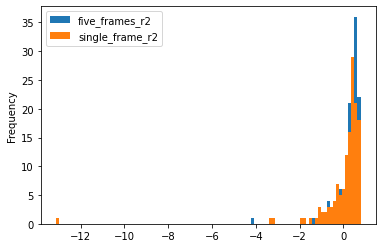

In [18]:
survey_results[['five_frames_r2', 'single_frame_r2']].plot.hist(bins=100)

In [19]:
survey_results.describe()

,survey_start_year,five_frames_r2,five_frames_rmse,single_frame_r2,single_frame_rmse,n_surveys
count,138.000000,138.000000,138.000000,138.000000,138.000000,138.000000
mean,2008.507246,0.257406,10.526964,0.020919,11.545727,414.456522
std,7.290877,0.589423,3.113504,1.312024,3.538908,275.220552
min,1991.000000,-4.122979,6.119983,-13.113142,6.338091,115.000000
25%,2004.000000,0.146819,8.378326,-0.112391,8.892906,239.750000
50%,2010.000000,0.415261,9.778684,0.340366,10.471479,350.500000
75%,2014.000000,0.605331,11.806503,0.528480,13.687352,515.750000
max,2019.000000,0.777349,23.223856,0.762067,24.770409,1688.000000


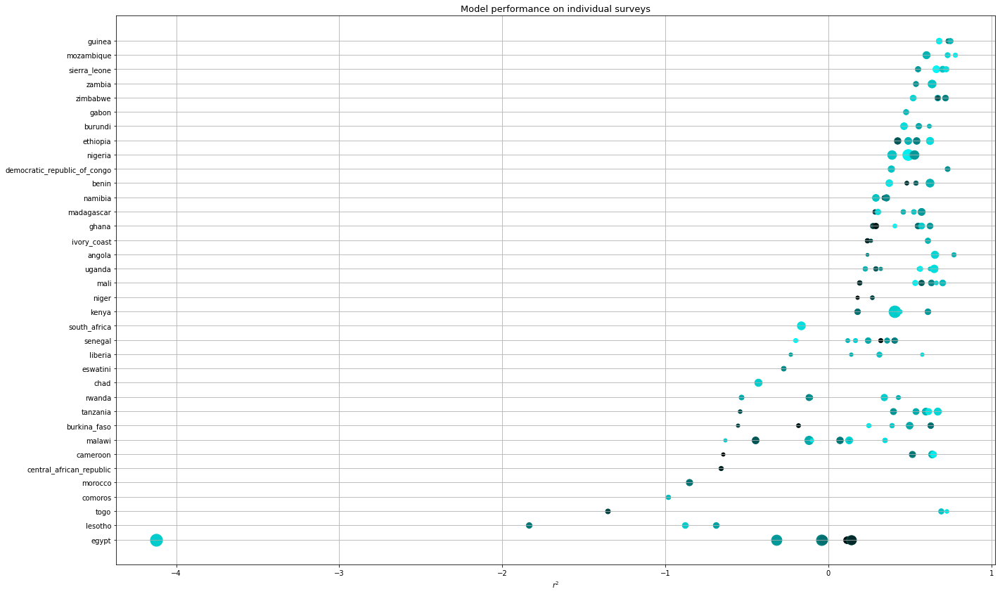

In [5]:
sns.color_palette("flare", as_cmap=True)

def plot_survey_performance(survey_results, title, urban_rural=False):

    fig, ax = plt.subplots(1, 1, figsize=(20, 12))
    for i in survey_results.sort_values('five_frames_r2').index:
        survey = survey_results.loc[i]
        r2 = survey['five_frames_r2']
        country = survey['country']
        year = survey['survey_start_year']
        size = (survey['n_surveys'] / len(df)) * 10000
        if urban_rural:
            color='orange' if survey['rural'] else 'blue'
        else:
            color = (year - 1990) / 30
            color = [(0, color, color)]
        ax.scatter(x=r2, y=country, label=year, s=size, c=color, cmap='flare')

    # ax.invert_yaxis()  # invert direction to put best-performing models at the top
    plt.rcParams.update({'font.size': 15})
    plt.rc('axes', titlesize=13)
    plt.rcParams.update({'font.size': 15})
    ax.grid(True)
    ax.set_title(title)
    ax.set_xlabel('$r^2$')
    # ax.legend(loc='center left',ncol=3, bbox_to_anchor=(1, 0.5))
    # x.legend(loc="lower left", ncol=5, bbox_to_anchor=(0, -1.28))
    fig.tight_layout()
    plt.show()
    
plot_survey_performance(survey_results, 'Model performance on individual surveys', urban_rural=False)

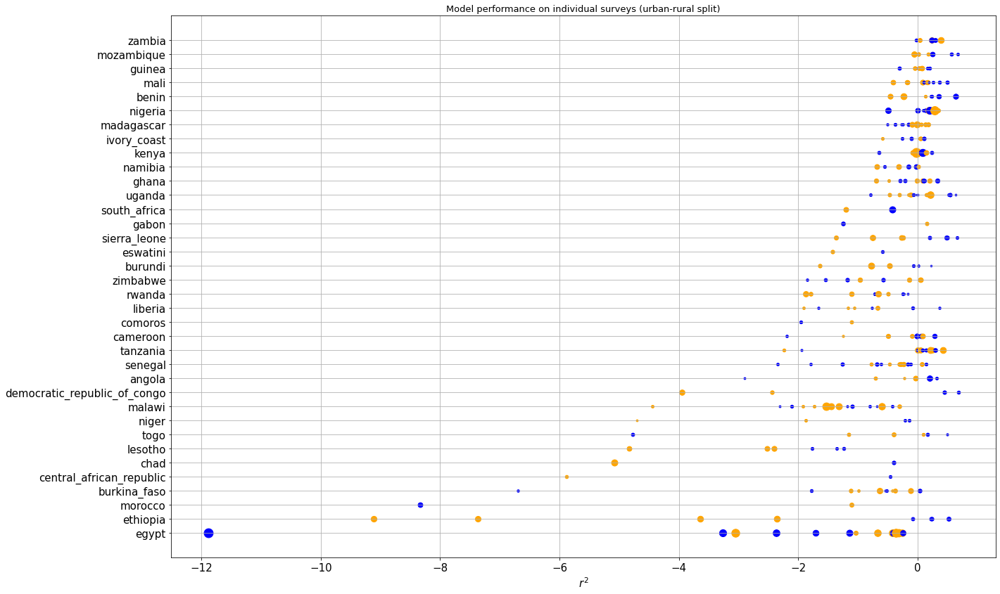

In [6]:
survey_results_ur = df.groupby(['country', 'survey_start_year', 'rural']).apply(r2_rmse).reset_index()
plot_survey_performance(survey_results_ur, 'Model performance on individual surveys (urban-rural split)', urban_rural=True)

In [10]:
sum(survey_results_ur['five_frames_r2'] < 0) / len(survey_results_ur)

0.6123188405797102

<AxesSubplot:ylabel='Frequency'>

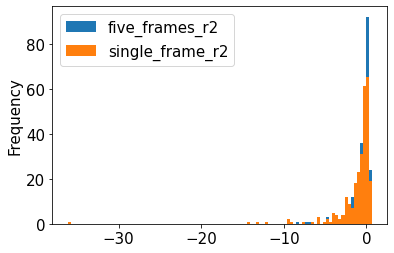

In [22]:
survey_results_ur[['five_frames_r2', 'single_frame_r2']].plot.hist(bins=100)

In [23]:
survey_results_ur.groupby('rural').mean()

,survey_start_year,five_frames_r2,five_frames_rmse,single_frame_r2,single_frame_rmse,n_surveys
rural,,,,,,
0,2008.507246,-0.545337,11.975222,-1.330125,13.843024,156.586957
1,2008.507246,-0.790863,9.453948,-1.040621,9.818246,257.869565


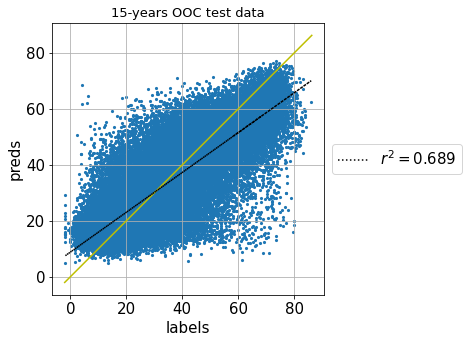

In [24]:
scatter_preds(df['iwi'], df['five_frames_pred'], title='15-years OOC test data')

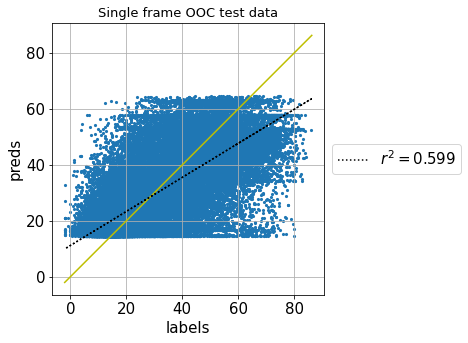

In [25]:
scatter_preds(df['iwi'], df['single_frame_pred'], title='Single frame OOC test data')

In [26]:
def r2_fold(g):
    g = g.dropna()
    five_frames_r2 = r2_score(g['iwi'], g['five_frames_pred'])
    five_frames_rmse = np.sqrt(mean_squared_error(g['iwi'], g['five_frames_pred']))
    single_frame_r2 = r2_score(g['iwi'], g['single_frame_pred'])
    single_frame_rmse = np.sqrt(mean_squared_error(g['iwi'], g['single_frame_pred']))
    return pd.Series({
        'five_frames_r2': five_frames_r2,
        'five_frames_rmse': five_frames_rmse,
        'single_frame_r2': single_frame_r2,
        'single_frame_rmse': single_frame_rmse,
        'n_surveys': len(g)
    })

df.groupby(['fold']).apply(r2_fold).reset_index()

,fold,five_frames_r2,five_frames_rmse,single_frame_r2,single_frame_rmse,n_surveys
0,A,0.729499,10.768570,0.477790,14.962233,11415.0
1,B,0.588974,10.837376,0.519523,11.717251,11372.0
2,C,0.389554,11.647698,0.374199,11.793274,11503.0
3,D,0.644030,8.821424,0.516820,10.277476,11520.0
4,E,0.550382,11.990961,0.485401,12.828224,11385.0


In [27]:
df[df['fold'] == 'A']['country'].unique()

array(['burundi', 'egypt', 'niger', 'south_africa', 'zambia'],
      dtype=object)

# Plot biggest changes

In [3]:
import data_handling

2022-09-19 14:50:16.773206: I tensorflow/stream_executor/platform/default/dso_loader.cc:54] Successfully opened dynamic library libcudart.so.11.0
2022-09-19 14:50:17.786303: I tensorflow/stream_executor/platform/default/dso_loader.cc:54] Successfully opened dynamic library libcuda.so.1
2022-09-19 14:50:17.832666: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1734] Found device 0 with properties: 
pciBusID: 0000:86:00.0 name: Tesla T4 computeCapability: 7.5
coreClock: 1.59GHz coreCount: 40 deviceMemorySize: 14.61GiB deviceMemoryBandwidth: 298.08GiB/s
2022-09-19 14:50:17.832717: I tensorflow/stream_executor/platform/default/dso_loader.cc:54] Successfully opened dynamic library libcudart.so.11.0
2022-09-19 14:50:17.837434: I tensorflow/stream_executor/platform/default/dso_loader.cc:54] Successfully opened dynamic library libcublas.so.11
2022-09-19 14:50:17.837499: I tensorflow/stream_executor/platform/default/dso_loader.cc:54] Successfully opened dynamic library libcublasLt.so.11
202

In [4]:
# get all tfrecords
tfrecord_files = np.asarray(data_handling.create_full_tfrecords_paths(data_dir))
df['file'] = tfrecord_files

In [9]:
df

,country,survey_start_year,year,lat,lon,GID_1,GID_2,households,rural,iwi,five_frames_pred,single_frame_pred,five_frames_err,single_frame_err,fold,ts_improvement,file
0,angola,2006,2006,-12.169283,13.859255,AGO.2,AGO.2.9,20,0,68.096300,14.628907,14.636230,53.467393,53.460070,E,-0.007323,/cephyr/NOBACKUP/groups/globalpoverty1/data/dh...
1,angola,2006,2006,-12.361700,14.778201,AGO.2,AGO.2.2,19,1,10.609053,23.293456,25.024414,12.684403,14.415361,E,1.730958,/cephyr/NOBACKUP/groups/globalpoverty1/data/dh...
2,angola,2006,2006,-10.827451,14.342114,AGO.7,AGO.7.1,25,1,29.973928,22.221680,15.502930,7.752248,14.470998,E,6.718750,/cephyr/NOBACKUP/groups/globalpoverty1/data/dh...
3,angola,2006,2006,-9.991311,14.898295,AGO.7,AGO.7.5,1,1,7.704135,20.556640,24.926758,12.852505,17.222623,E,4.370118,/cephyr/NOBACKUP/groups/globalpoverty1/data/dh...
4,angola,2006,2006,-11.518893,14.750437,AGO.7,AGO.7.10,24,1,13.371826,15.729980,14.685059,2.358154,1.313233,E,-1.044921,/cephyr/NOBACKUP/groups/globalpoverty1/data/dh...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57190,zimbabwe,2015,2015,-20.911177,30.008579,ZWE.10,ZWE.10.6,28,1,27.791567,18.115234,16.796875,9.676333,10.994692,B,1.318359,/cephyr/NOBACKUP/groups/globalpoverty1/data/dh...
57191,zimbabwe,2015,2015,-20.402214,29.860028,ZWE.10,ZWE.10.8,28,1,36.929878,22.033691,23.364258,14.896187,13.565620,B,-1.330567,/cephyr/NOBACKUP/groups/globalpoverty1/data/dh...
57192,zimbabwe,2015,2015,-20.724753,30.172833,ZWE.10,ZWE.10.6,27,1,24.406326,14.288330,16.748047,10.117996,7.658279,B,-2.459717,/cephyr/NOBACKUP/groups/globalpoverty1/data/dh...
57193,zimbabwe,2015,2015,-19.453466,29.820084,ZWE.10,ZWE.10.4,28,0,59.887344,46.728516,40.356445,13.158828,19.530899,B,6.372071,/cephyr/NOBACKUP/groups/globalpoverty1/data/dh...


country                   chad
year                      2015
ts_improvement      -40.649411
five_frames_pred      57.34863
single_frame_pred    16.699219
iwi                  16.501532
Name: 7653, dtype: object


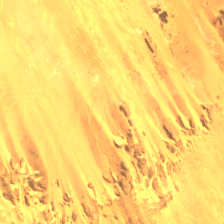

country                   chad
year                      2015
ts_improvement      -30.957031
five_frames_pred     63.720703
single_frame_pred    32.763672
iwi                  18.294275
Name: 7652, dtype: object


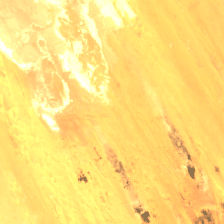

country                lesotho
year                      2014
ts_improvement       -30.92041
five_frames_pred     50.439453
single_frame_pred    19.519043
iwi                  18.478546
Name: 27517, dtype: object


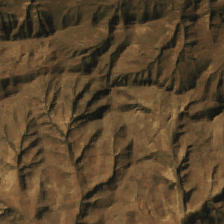

country                   chad
year                      2015
ts_improvement      -30.916403
five_frames_pred     48.339844
single_frame_pred    16.699219
iwi                   17.06133
Name: 7648, dtype: object


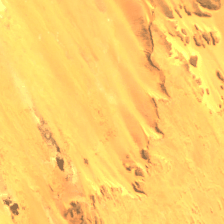

country                   chad
year                      2015
ts_improvement      -30.883789
five_frames_pred     68.530273
single_frame_pred    37.646484
iwi                   4.180192
Name: 7642, dtype: object


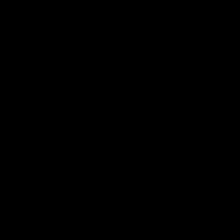

country                lesotho
year                      2004
ts_improvement       -29.96338
five_frames_pred     51.044923
single_frame_pred    21.081543
iwi                  10.777032
Name: 26592, dtype: object


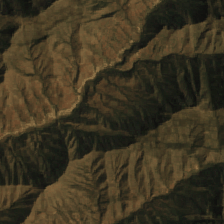

country                lesotho
year                      2004
ts_improvement      -28.413087
five_frames_pred     45.307618
single_frame_pred    16.894531
iwi                  16.703212
Name: 26585, dtype: object


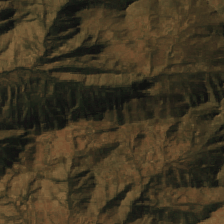

country                namibia
year                      2000
ts_improvement      -27.661132
five_frames_pred     45.056152
single_frame_pred     17.39502
iwi                  12.684574
Name: 37073, dtype: object


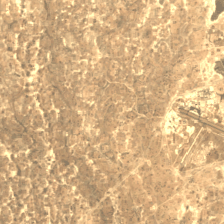

country                   chad
year                      2014
ts_improvement      -27.270506
five_frames_pred      64.67285
single_frame_pred    37.402344
iwi                   6.169385
Name: 7438, dtype: object


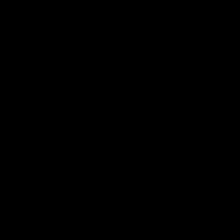

country                lesotho
year                      2009
ts_improvement      -27.216357
five_frames_pred      49.51172
single_frame_pred    18.200684
iwi                  20.248023
Name: 26912, dtype: object


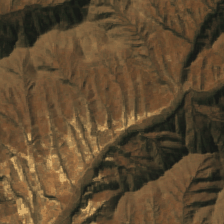

country                nigeria
year                      2018
ts_improvement      -27.197266
five_frames_pred      57.56836
single_frame_pred    30.371094
iwi                  27.558759
Name: 42182, dtype: object


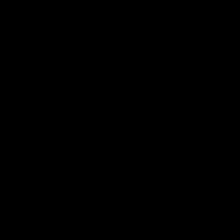

country                lesotho
year                      2014
ts_improvement      -27.063972
five_frames_pred     45.214844
single_frame_pred    16.992188
iwi                   17.57153
Name: 27509, dtype: object


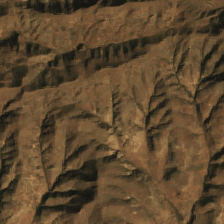

country                lesotho
year                      2014
ts_improvement      -26.794431
five_frames_pred      51.75781
single_frame_pred    24.963379
iwi                   15.09813
Name: 27401, dtype: object


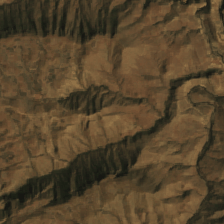

country                lesotho
year                      2014
ts_improvement        -26.3916
five_frames_pred      46.45996
single_frame_pred     20.06836
iwi                  14.891971
Name: 27501, dtype: object


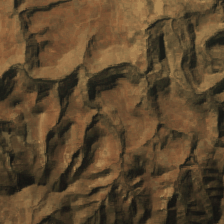

country              ivory_coast
year                        1994
ts_improvement         -25.45166
five_frames_pred        22.44873
single_frame_pred       47.90039
iwi                    48.331576
Name: 23193, dtype: object


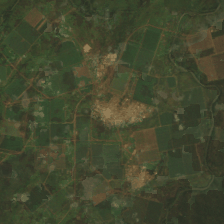

In [10]:
# Get 15 least improved
least_improved_files = df.sort_values('ts_improvement', ascending=True)['file'].values[:15]
ds = data_handling.get_inference_dataset(least_improved_files, batch_size=0, normalize=False, labeled=False)
for x in ds.as_numpy_iterator():
    i = x['sample_index']
    print(df.loc[i, ['country', 'year', 'ts_improvement', 'five_frames_pred', 'single_frame_pred', 'iwi']])
    to_gif(x['model_input'])

country                  egypt
year                      2014
ts_improvement       37.866211
five_frames_pred     72.631836
single_frame_pred    34.765625
iwi                  75.336164
Name: 16477, dtype: object
31.315920, 30.107368


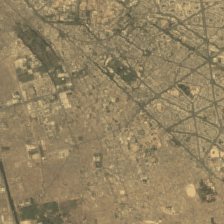

country                  egypt
year                      2008
ts_improvement        36.40137
five_frames_pred      73.12012
single_frame_pred     36.71875
iwi                  73.951253
Name: 14641, dtype: object
31.023552, 30.020362


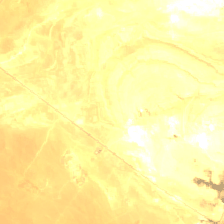

country                  egypt
year                      2014
ts_improvement       33.756904
five_frames_pred     69.677734
single_frame_pred    33.789062
iwi                   68.61185
Name: 16309, dtype: object
31.301765, 30.113150


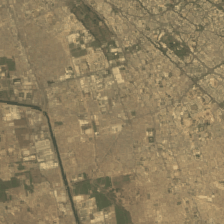

country                  egypt
year                      2014
ts_improvement       33.361815
five_frames_pred      55.05371
single_frame_pred    21.691895
iwi                  63.929838
Name: 15763, dtype: object
30.443688, 29.205267


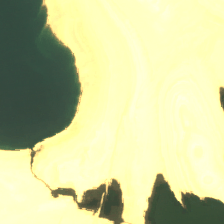

country                  egypt
year                      2003
ts_improvement       32.714843
five_frames_pred      58.05664
single_frame_pred    25.341797
iwi                  60.378415
Name: 11774, dtype: object
31.193800, 30.758820


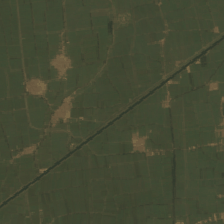

country                  egypt
year                      2014
ts_improvement       32.080078
five_frames_pred       73.4375
single_frame_pred    41.357422
iwi                   79.70721
Name: 16516, dtype: object
31.330643, 30.062105


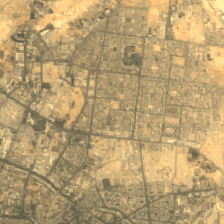

country              south_africa
year                         2016
ts_improvement          31.860352
five_frames_pred        69.750977
single_frame_pred       37.890625
iwi                     80.506944
Name: 48752, dtype: object
18.525062, -33.870671


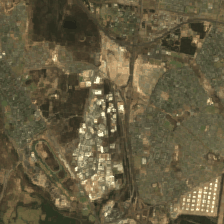

country                  egypt
year                      2014
ts_improvement       31.860351
five_frames_pred      53.24707
single_frame_pred    21.386719
iwi                   61.38402
Name: 15743, dtype: object
30.448829, 29.204410


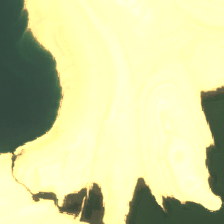

country                  egypt
year                      2014
ts_improvement       31.738282
five_frames_pred     70.996094
single_frame_pred    39.257812
iwi                  73.303056
Name: 16400, dtype: object
31.334346, 30.114288


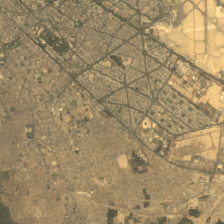

country                  egypt
year                      2014
ts_improvement        30.39551
five_frames_pred      52.39258
single_frame_pred     21.99707
iwi                  64.338853
Name: 15730, dtype: object
30.428788, 29.201659


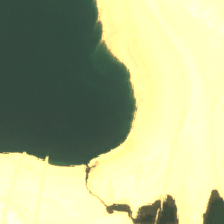

country                  egypt
year                      2014
ts_improvement       30.126953
five_frames_pred     64.404297
single_frame_pred    34.277344
iwi                  66.006479
Name: 16263, dtype: object
28.968571, 30.837591


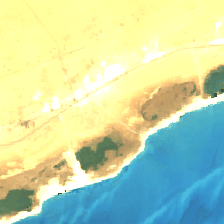

country                 malawi
year                      2005
ts_improvement       30.014652
five_frames_pred     29.165038
single_frame_pred     59.17969
iwi                  23.445175
Name: 31125, dtype: object
33.791487, -13.866694


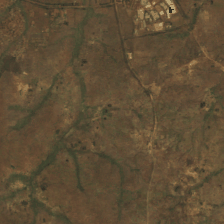

country               zimbabwe
year                      2010
ts_improvement       29.553222
five_frames_pred     31.481934
single_frame_pred    61.035156
iwi                  29.966164
Name: 56458, dtype: object
31.168425, -17.883342


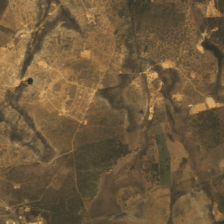

country                  egypt
year                      2005
ts_improvement       29.179684
five_frames_pred       63.4082
single_frame_pred    34.228516
iwi                  67.929513
Name: 13716, dtype: object
29.512475, 30.949377


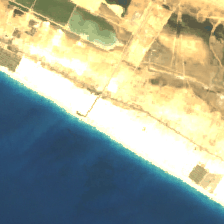

country                  egypt
year                      2014
ts_improvement       28.925607
five_frames_pred     73.046875
single_frame_pred    33.691406
iwi                  67.831944
Name: 16535, dtype: object
31.290148, 30.047814


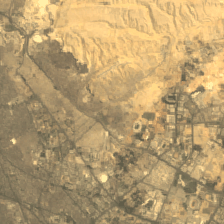

In [11]:
# Get 15 most improved
most_improved_files = df.sort_values('ts_improvement', ascending=False)['file'].values[:15]
ds = data_handling.get_inference_dataset(most_improved_files, batch_size=0, normalize=False, labeled=False)
for x in ds.as_numpy_iterator():
    i = x['sample_index']
    row = df.loc[i]
    print(row[['country', 'year', 'ts_improvement', 'five_frames_pred', 'single_frame_pred', 'iwi']])
    print(f"{row['lon']:.6f}, {row['lat']:.6f}")
    to_gif(x['model_input'])